Possible Visualizations:
1. World Map color coded by cluster
2. Plot to visualize the shifts

In [27]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [20]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import math
%matplotlib inline
plt.style.use('seaborn')
import os
import seaborn as sns

In [28]:
BASE_DIR = '/content/drive/My Drive/4th Year/CS 197 (Thesis)/FINAL - COVID Modeling/notebooks/data/'
df_kmeans = pd.read_csv(os.path.join(BASE_DIR, 'new_clustered_countries.csv'), index_col=0)
df_kshape = pd.read_csv(os.path.join(BASE_DIR, 'new_clustered_countries_kshape_6months.csv'), index_col=0)
df_outliers = pd.read_csv(os.path.join(BASE_DIR, 'outlier_countries.csv'), index_col=0)

In [29]:
df_kmeans['labels'] = df_kmeans['labels'] + 1
df_kmeans.head()

,Province/State,Country/Region,Lat,Long,populations,area,1/22/20_confirmed,1/23/20_confirmed,1/24/20_confirmed,1/25/20_confirmed,1/26/20_confirmed,1/27/20_confirmed,1/28/20_confirmed,1/29/20_confirmed,1/30/20_confirmed,1/31/20_confirmed,2/1/20_confirmed,2/2/20_confirmed,2/3/20_confirmed,2/4/20_confirmed,2/5/20_confirmed,2/6/20_confirmed,2/7/20_confirmed,2/8/20_confirmed,2/9/20_confirmed,2/10/20_confirmed,2/11/20_confirmed,2/12/20_confirmed,2/13/20_confirmed,2/14/20_confirmed,2/15/20_confirmed,2/16/20_confirmed,2/17/20_confirmed,2/18/20_confirmed,2/19/20_confirmed,2/20/20_confirmed,2/21/20_confirmed,2/22/20_confirmed,2/23/20_confirmed,2/24/20_confirmed,...,shift 38,shift 39,shift 40,shift 41,shift 42,shift 43,shift 44,shift 45,shift 46,shift 47,shift 48,shift 49,shift 50,shift 51,shift 52,shift 53,shift 54,shift 55,shift 56,shift 57,shift 58,shift 59,shift 60,shift 61,shift 62,shift 63,shift 64,shift 65,shift 66,shift 67,shift 68,shift 69,shift 70,shift 71,shift 72,shift 73,shift 74,shift 75,shift 76,labels
0,no province,Afghanistan,33.93911,67.709953,38928346.0,no province Afghanistan,3.611916e-11,1.264171e-10,3.371122e-10,7.585024e-10,1.510985e-09,2.745056e-09,4.611213e-09,7.229852e-09,1.066117e-08,1.487508e-08,1.972106e-08,2.492824e-08,3.012338e-08,3.490917e-08,3.894850e-08,4.206076e-08,4.431821e-08,4.612417e-08,4.825520e-08,5.183702e-08,5.827827e-08,6.918024e-08,8.618634e-08,1.108076e-07,1.443201e-07,1.875728e-07,2.409449e-07,3.042437e-07,3.768372e-07,4.579549e-07,5.471692e-07,6.447873e-07,7.526030e-07,8.741138e-07,...,0.7,0.7,0.7,0.7,0.2,0.0,0.0,0.1,0.7,0.9,1.0,1.0,0.5,0.7,0.9,1.0,1.0,1.0,0.5,0.7,0.7,0.7,0.7,0.7,0.7,0.7,0.7,0.7,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,3
1,no province,Albania,41.15330,20.168300,2877797.0,no province Albania,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.628629e-10,1.628629e-09,7.491694e-09,2.467373e-08,6.661093e-08,1.561855e-07,3.283316e-07,6.323967e-07,1.130676e-06,1.895643e-06,3.002704e-06,4.519039e-06,6.490983e-06,8.933764e-06,1.182092e-05,1.508420e-05,1.861898e-05,2.230033e-05,2.600644e-05,2.964529e-05,3.317412e-05,...,1.0,0.5,0.7,0.7,0.9,1.0,1.0,0.3,0.0,0.0,0.1,0.9,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.5,0.9,1.0,0.5,0.7,0.9,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,1
2,no province,Algeria,28.03390,1.659600,43851044.0,no province Algeria,5.344074e-12,3.206444e-11,1.122255e-10,2.992681e-10,6.733533e-10,1.341362e-09,2.447586e-09,4.168377e-09,6.744221e-09,1.051179e-08,1.596275e-08,2.379182e-08,3.497162e-08,5.074198e-08,7.259924e-08,1.020718e-07,1.405171e-07,1.887847e-07,2.469871e-07,3.142743e-07,3.889096e-07,4.684081e-07,5.502472e-07,6.324818e-07,7.145828e-07,7.981321e-07,8.875758e-07,9.904706e-07,1.117708e-06,1.282962e-06,1.502390e-06,1.794161e-06,2.177571e-06,2.671347e-06,...,0.7,0.7,0.7,0.7,0.7,0.7,0.2,0.0,0.1,0.9,1.0,0.5,0.7,0.7,0.7,0.9,0.5,0.7,0.7,0.9,1.0,1.0,1.0,0.5,0.7,0.7,0.7,0.7,0.7,0.7,0.7,0.2,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,3
3,no province,Andorra,42.50630,1.521800,77265.0,no province Andorra,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.032980e-09,1.819788e-08,6.369258e-08,1.698469e-07,3.821555e-07,7.612780e-07,1.383039e-06,2.323263e-06,3.642609e-06,5.371408e-06,7.494494e-06,9.936043e-06,1.255957e-05,1.516793e-05,1.753669e-05,1.955969e-05,2.139464e-05,2.365118e-05,2.764561e-05,3.566178e-05,5.117547e-05,7.909406e-05,1.254865e-04,1.973196e-04,3.020515e-04,4.469460e-04,6.382998e-04,8.808351e-04,...,0.2,0.0,0.0,0.1,0.7,0.2,0.0,0.0,0.1,0.9,1.0,0.5,0.7,0.2,0.0,0.0,0.0,0.1,0.9,1.0,1.0,0.5,0.7,0.7,0.7,0.2,0.0,0.1,0.7,0.7,0.7,0.9,1.0,1.0,1.0,1.0,1.0,-1.0,-1,4
4,no province,Angola,-11.20270,17.873900,32866272.0,no province Angola,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+0

In [30]:
df_kshape['labels'] = df_kshape['labels'] + 1
df_kshape.head()

,Province/State,Country/Region,Lat,Long,populations,area,9/1/20_confirmed,9/2/20_confirmed,9/3/20_confirmed,9/4/20_confirmed,9/5/20_confirmed,9/6/20_confirmed,9/7/20_confirmed,9/8/20_confirmed,9/9/20_confirmed,9/10/20_confirmed,9/11/20_confirmed,9/12/20_confirmed,9/13/20_confirmed,9/14/20_confirmed,9/15/20_confirmed,9/16/20_confirmed,9/17/20_confirmed,9/18/20_confirmed,9/19/20_confirmed,9/20/20_confirmed,9/21/20_confirmed,9/22/20_confirmed,9/23/20_confirmed,9/24/20_confirmed,9/25/20_confirmed,9/26/20_confirmed,9/27/20_confirmed,9/28/20_confirmed,9/29/20_confirmed,9/30/20_confirmed,10/1/20_confirmed,10/2/20_confirmed,10/3/20_confirmed,10/4/20_confirmed,...,1/24/21_deaths,1/25/21_deaths,1/26/21_deaths,1/27/21_deaths,1/28/21_deaths,1/29/21_deaths,1/30/21_deaths,1/31/21_deaths,2/1/21_deaths,2/2/21_deaths,2/3/21_deaths,2/4/21_deaths,2/5/21_deaths,2/6/21_deaths,2/7/21_deaths,2/8/21_deaths,2/9/21_deaths,2/10/21_deaths,2/11/21_deaths,2/12/21_deaths,2/13/21_deaths,2/14/21_deaths,2/15/21_deaths,shifts,shift 1,shift 2,shift 3,shift 4,shift 5,shift 6,shift 7,shift 8,shift 9,shift 10,shift 11,shift 12,shift 13,shift 14,shift 15,labels
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,1.067715e-07,5.490283e-07,0.000002,0.000004,0.000008,0.000015,0.000026,0.000040,0.000060,0.000084,0.000111,0.000142,0.000175,0.000208,0.000238,0.000266,0.000289,0.000308,0.000322,0.000332,0.000339,0.000342,0.000344,0.000344,0.000342,0.000340,0.000337,0.000332,...,0.002159,0.002136,0.002103,0.002060,0.002008,0.001948,0.001882,0.001811,0.001737,0.001659,0.001580,0.001500,0.001420,0.001339,0.001256,0.001171,0.001084,0.000994,0.000905,0.000816,0.000731,0.000653,0.000584,13,0,0,0,0,0,1,5,5,5,5,2,0,-1,-1,-1,3
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,5.356425e-06,2.702371e-05,0.000082,0.000193,0.000389,0.000706,0.001188,0.001861,0.002739,0.003819,0.005080,0.006483,0.007970,0.009462,0.010892,0.012205,0.013357,0.014321,0.015085,0.015654,0.016053,0.016306,0.016436,0.016465,0.016415,0.016304,0.016146,0.015951,...,0.019107,0.018751,0.018382,0.018032,0.017737,0.017529,0.017437,0.017485,0.017687,0.018053,0.018583,0.019270,0.020106,0.021078,0.022163,0.023333,0.024559,0.025819,0.027098,0.028386,0.029674,0.030964,0.032269,13,1,5,5,5,7,8,8,8,8,8,8,8,-1,-1,-1,1
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,9.793922e-07,4.867298e-06,0.000015,0.000034,0.000067,0.000120,0.000199,0.000307,0.000445,0.000609,0.000795,0.000993,0.001194,0.001383,0.001551,0.001689,0.001793,0.001864,0.001901,0.001910,0.001898,0.001871,0.001834,0.001791,0.001746,0.001699,0.001653,0.001606,...,0.001002,0.000979,0.000959,0.000940,0.000924,0.000911,0.000899,0.000890,0.000883,0.000877,0.000872,0.000867,0.000862,0.000857,0.000851,0.000845,0.000837,0.000829,0.000819,0.000808,0.000797,0.000785,0.000774,13,0,1,5,5,5,5,5,5,5,5,5,5,-1,-1,-1,1
3,no province,Andorra,42.50630,1.521800,77265,no province Andorra,0.0,0.0,0.0,0.0,0.0,0.0,2.220478e-05,1.098629e-04,0.000328,0.000763,0.001526,0.002754,0.004613,0.007212,0.010610,0.014822,0.019811,0.025494,0.031727,0.038305,0.045077,0.051932,0.058791,0.065605,0.072352,0.079037,0.085706,0.092366,0.099000,0.105572,0.112031,0.118322,0.124381,0.130136,...,0.044249,0.052164,0.060007,0.067382,0.073978,0.079573,0.084071,0.087510,0.090018,0.091821,0.093133,0.094092,0.094762,0.095144,0.095180,0.094827,0.093983,0.092563,0.090602,0.088223,0.085563,0.082737,0.079767,13,1,7,8,8,8,8,8,8,8,8,8,8,-1,-1,-1,1
4,no province,Angola,-11.20270,17.873900,32866272,no province Angola,0.0,0.0,0.0,0.0,0.0,0.0,2.100550e-07,1.040494e-06,0.000003,0.000007,0.000014,0.000026,0.000042,0.000066,0.000096,0.000133,0.000175,0.000222,0.000272,0.000323,0.000373,0.000420,0.000466,0.000508,0.000547,0.000584,0.000619,0.000654,0.000687,0.000720,0.000751,0.000782,0.000811,0.000838,...,0.000488,0.000524,0.000565,0.000608,0.000652,0.000695,0.000736,0.000771,0.000798,0.000816

In [31]:
df_outliers.head()

,Province/State,Country/Region,Lat,Long,total_cases,area,populations,peak_cases,normalized_peak,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,...,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,11/10/20,11/11/20,11/12/20,11/13/20,11/14/20,11/15/20,11/16/20,11/17/20
3,no province,Andorra,42.5063,1.5218,5951,no province Andorra,77265.0,299.0,0.003870,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,128,0,0,299,0,195,0,187,0,0,246,0,188,0,227,0,0,287,85,107,50,98,91,69,63,22,135,90,0,184,64,54,40,90,49,109,0,147,42,37
4,no province,Angola,-11.2027,17.8739,13818,no province Angola,32866272.0,355.0,0.000011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,73,215,120,122,192,166,250,126,240,160,207,220,289,244,247,197,355,263,227,203,195,289,247,230,193,349,236,289,121,112,98,247,136,137,100,175,146,77,164,203
5,no province,Antigua and Barbuda,17.0608,-61.7964,134,no province Antigua and Barbuda,97929.0,39.0,0.000398,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,7,0,0,0,3,0,0,2,0,0,0,0,0,3,1,0,0,0,2,0,0,1,0,0,0,0,0,2,1,0,0,0
8,Australian Capital Territory,Australia,-35.4735,149.0124,115,Australian Capital Territory Australia,429834.0,14.0,0.000033,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
9,New South Wales,Australia,-33.8688,151.2093,4509,New South Wales Australia,8158000.0,241.0,0.000030,0,0,0,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2,5,6,11,15,11,5,7,5,4,5,10,6,7,5,7,4,12,8,5,6,4,4,7,3,8,2,9,5,3,7,0,0,0,0,0,17,12,4,7


# Removing Outlier Countries
Commenting out this section because this was _before_ we removed the outliers at the start of the pipeline already.

In [ ]:
# df_kshape_no_outliers = df_kshape[~df_kshape['area'].isin(df_outliers['area'])]
# df_kshape_no_outliers.head()

,Province/State,Country/Region,Lat,Long,populations,area,1/22/20_confirmed,1/23/20_confirmed,1/24/20_confirmed,1/25/20_confirmed,1/26/20_confirmed,1/27/20_confirmed,1/28/20_confirmed,1/29/20_confirmed,1/30/20_confirmed,1/31/20_confirmed,2/1/20_confirmed,2/2/20_confirmed,2/3/20_confirmed,2/4/20_confirmed,2/5/20_confirmed,2/6/20_confirmed,2/7/20_confirmed,2/8/20_confirmed,2/9/20_confirmed,2/10/20_confirmed,2/11/20_confirmed,2/12/20_confirmed,2/13/20_confirmed,2/14/20_confirmed,2/15/20_confirmed,2/16/20_confirmed,2/17/20_confirmed,2/18/20_confirmed,2/19/20_confirmed,2/20/20_confirmed,2/21/20_confirmed,2/22/20_confirmed,2/23/20_confirmed,2/24/20_confirmed,...,2/13/21_recovered,2/14/21_recovered,2/15/21_recovered,shifts,shift 1,shift 2,shift 3,shift 4,shift 5,shift 6,shift 7,shift 8,shift 9,shift 10,shift 11,shift 12,shift 13,shift 14,shift 15,shift 16,shift 17,shift 18,shift 19,shift 20,shift 21,shift 22,shift 23,shift 24,shift 25,shift 26,shift 27,shift 28,shift 29,shift 30,shift 31,shift 32,shift 33,shift 34,shift 35,labels
0,no province,Afghanistan,33.93911,67.709953,38928346,no province Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.601755e-11,...,0.001147,0.001066,0.001002,28,0,0,0,0,0,1,5,5,5,7,8,4,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,-1,-1,-1,-1,-1,-1,-1,-1,3
1,no province,Albania,41.15330,20.168300,2877797,no province Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.016456,0.016702,0.017000,28,0,0,0,0,1,5,5,5,5,5,5,7,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,-1,-1,-1,-1,-1,-1,-1,-1,3
2,no province,Algeria,28.03390,1.659600,43851044,no province Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.002852,0.002833,0.002815,28,0,0,0,0,1,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,7,8,8,4,5,5,5,-1,-1,-1,-1,-1,-1,-1,-1,3
6,no province,Argentina,-38.41610,-63.616700,45195774,no province Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.007784,0.007615,0.007442,27,0,0,0,0,1,5,5,5,5,7,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,-1,-1,-1,-1,-1,-1,-1,-1,-1,3
7,no province,Armenia,40.06910,45.038200,2963243,no province Armenia,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,...,0.004802,0.004680,0.004521,29,0,0,0,0,1,5,7,4,7,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,-1,-1,-1,-1,-1,-1,-1,3


In [ ]:
# df_kmeans_no_outliers = df_kmeans[~df_kmeans.index.isin(df_outliers.index)]
# df_kmeans_no_outliers.head()

,Province/State,Country/Region,Lat,Long,populations,area,1/22/20_confirmed,1/23/20_confirmed,1/24/20_confirmed,1/25/20_confirmed,1/26/20_confirmed,1/27/20_confirmed,1/28/20_confirmed,1/29/20_confirmed,1/30/20_confirmed,1/31/20_confirmed,2/1/20_confirmed,2/2/20_confirmed,2/3/20_confirmed,2/4/20_confirmed,2/5/20_confirmed,2/6/20_confirmed,2/7/20_confirmed,2/8/20_confirmed,2/9/20_confirmed,2/10/20_confirmed,2/11/20_confirmed,2/12/20_confirmed,2/13/20_confirmed,2/14/20_confirmed,2/15/20_confirmed,2/16/20_confirmed,2/17/20_confirmed,2/18/20_confirmed,2/19/20_confirmed,2/20/20_confirmed,2/21/20_confirmed,2/22/20_confirmed,2/23/20_confirmed,2/24/20_confirmed,...,shift 38,shift 39,shift 40,shift 41,shift 42,shift 43,shift 44,shift 45,shift 46,shift 47,shift 48,shift 49,shift 50,shift 51,shift 52,shift 53,shift 54,shift 55,shift 56,shift 57,shift 58,shift 59,shift 60,shift 61,shift 62,shift 63,shift 64,shift 65,shift 66,shift 67,shift 68,shift 69,shift 70,shift 71,shift 72,shift 73,shift 74,shift 75,shift 76,labels
0,no province,Afghanistan,33.93911,67.709953,38928346.0,no province Afghanistan,3.611916e-11,1.264171e-10,3.371122e-10,7.585024e-10,1.510985e-09,2.745056e-09,4.611213e-09,7.229852e-09,1.066117e-08,1.487508e-08,1.972106e-08,2.492824e-08,3.012338e-08,3.490917e-08,3.894850e-08,4.206076e-08,4.431821e-08,4.612417e-08,4.825520e-08,5.183702e-08,5.827827e-08,6.918024e-08,8.618634e-08,1.108076e-07,1.443201e-07,1.875728e-07,2.409449e-07,3.042437e-07,3.768372e-07,4.579549e-07,5.471692e-07,6.447873e-07,7.526030e-07,8.741138e-07,...,0.7,0.7,0.7,0.7,0.2,0.0,0.0,0.1,0.7,0.9,1.0,1.0,0.5,0.7,0.9,1.0,1.0,1.0,0.5,0.7,0.7,0.7,0.7,0.7,0.7,0.7,0.7,0.7,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,3
1,no province,Albania,41.15330,20.168300,2877797.0,no province Albania,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.628629e-10,1.628629e-09,7.491694e-09,2.467373e-08,6.661093e-08,1.561855e-07,3.283316e-07,6.323967e-07,1.130676e-06,1.895643e-06,3.002704e-06,4.519039e-06,6.490983e-06,8.933764e-06,1.182092e-05,1.508420e-05,1.861898e-05,2.230033e-05,2.600644e-05,2.964529e-05,3.317412e-05,...,1.0,0.5,0.7,0.7,0.9,1.0,1.0,0.3,0.0,0.0,0.1,0.9,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.5,0.9,1.0,0.5,0.7,0.9,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,1
2,no province,Algeria,28.03390,1.659600,43851044.0,no province Algeria,5.344074e-12,3.206444e-11,1.122255e-10,2.992681e-10,6.733533e-10,1.341362e-09,2.447586e-09,4.168377e-09,6.744221e-09,1.051179e-08,1.596275e-08,2.379182e-08,3.497162e-08,5.074198e-08,7.259924e-08,1.020718e-07,1.405171e-07,1.887847e-07,2.469871e-07,3.142743e-07,3.889096e-07,4.684081e-07,5.502472e-07,6.324818e-07,7.145828e-07,7.981321e-07,8.875758e-07,9.904706e-07,1.117708e-06,1.282962e-06,1.502390e-06,1.794161e-06,2.177571e-06,2.671347e-06,...,0.7,0.7,0.7,0.7,0.7,0.7,0.2,0.0,0.1,0.9,1.0,0.5,0.7,0.7,0.7,0.9,0.5,0.7,0.7,0.9,1.0,1.0,1.0,0.5,0.7,0.7,0.7,0.7,0.7,0.7,0.7,0.2,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,3
6,no province,Argentina,-38.41610,-63.616700,45195774.0,no province Argentina,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.185069e-12,3.111041e-11,1.088865e-10,2.955489e-10,7.155395e-10,1.617742e-09,3.432516e-09,6.828736e-09,1.277601e-08,2.257579e-08,3.790804e-08,6.073790e-08,9.317569e-08,1.373836e-07,1.954667e-07,2.693332e-07,3.607875e-07,4.715717e-07,6.037391e-07,7.605252e-07,9.471099e-07,1.171629e-06,1.446100e-06,1.787096e-06,2.216145e-06,2.759831e-06,3.447397e-06,...,1.0,1.0,1.0,0.5,0.7,0.2,0.0,0.1,0.9,1.0,1.0,0.5,0.9,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.5,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1,1
7,no province,Armenia,40.06910,45.038200,2963243.0,no province Armenia,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,7.908336e-11,4.745002e-10,1.660751e-09,4.428668e-09,9.964503e-09,1.984992e-08,3.606201e-08,6.05

# Visualizing the Clusters

In [7]:
def get_random_color():
  import random
  r = lambda: random.randint(0,255)
  return ('#%02X%02X%02X' % (r(),r(),r()))
  # return list(np.random.choice(range(0, 1), size=3))

In [8]:
# All countries
def get_single_graph(df, area):
  last_columns = 18

  fig, ax = plt.subplots(3, 1, figsize=(30,15))
  titles = ["Confirmed", "Fatality Rate", "Recovery Rate"]

  columns = df.columns[6:-last_columns]
  num_columns = len(columns) // 3
  df_cluster = df[df['area'] == area]

  for i in range(3):
    ax[i].set_title(titles[i])
    ax[i].set_xlabel("Dates")
    ax[i].set_ylabel("Normalized Cases")
    ax[i].get_xaxis().set_ticks([])

    x = columns[i*num_columns:i*num_columns + num_columns]

    for idx, curr_area in df_cluster.iterrows():
      y = curr_area[x]
      
      ax[i].plot(x,y,label=curr_area['area'])

  fig.suptitle('{} Normalized Cases'.format(area), fontsize=18)

In [59]:
# Consensus - mean of each date
def get_consensus(df, cluster_num=0):
  last_columns = 18

  columns = df.columns[6:-last_columns]
  num_columns = len(columns) // 3
  df_cluster = df[df['labels'] == cluster_num]
  new_row = {
    'area': 'Consensus #%d' % cluster_num, 
    'label': cluster_num,
  }

  for col in columns:
    df_curr_date = df_cluster[col]
    stat = df_curr_date.mean()
    # stat = df_curr_date.median()
    new_row[col] = stat

  fig, ax = plt.subplots(3, 1, figsize=(18,10))
  titles = ["Confirmed", "Fatality Rate", "Recovery Rate"]

  for i in range(3):
    ax[i].set_title(titles[i])
    ax[i].set_xlabel("Dates")
    ax[i].set_ylabel("Normalized Cases")
    ax[i].get_xaxis().set_ticks([])

    x = columns[i*num_columns:i*num_columns + num_columns]
    y = [value for key, value in new_row.items() if key in x]
      
    ax[i].plot(x,y)

  fig.suptitle('Cluster #{} Consensus Graphs'.format(cluster_num), fontsize=18)

  return new_row

In [104]:
# Shift the columns of each row so that it starts with one zero and then the
# rest are the nonzero values
def shift_df_cols(df, num_divs):
  labels = ['confirmed', 'deaths']
  # labels = ['confirmed', 'deaths', 'recoveries']
  columns = df.columns
  num_columns = len(columns) // num_divs

  shifted_df = pd.DataFrame()
  for idx, row in df.iterrows():
    combined_series = []
    for i in range(num_divs):
      curr_cols = columns[i*num_columns:i*num_columns + num_columns]
      temp = row[curr_cols] != 0
      # Get the first nonzero column in each country onwards
      curr_cols = curr_cols[curr_cols.get_loc(temp.idxmax()):]
      shifted_row = row[curr_cols]
      shifted_row.index = [labels[i] + '_' + f'{col_idx+1:03d}' for col_idx in range(len(shifted_row.index))]
      combined_series.append(shifted_row)
    combined_series = pd.concat(combined_series, axis=0)

    shifted_df = shifted_df.append(combined_series)
  
  shifted_df['confirmed_000'] = 0
  shifted_df['deaths_000'] = 0
  # shifted_df['recoveries_000'] = 0

  shifted_df = shifted_df.reindex(sorted(shifted_df.columns), axis=1)
  
  return shifted_df

# Consensus - mean of each change in cases
def get_consensus_2(df, cluster_num=0, num_divs=2):
  last_columns = 17

  columns = df.columns[6:-last_columns]
  df_cluster = df[df['labels'] == cluster_num][columns]

  # shifted_df = shift_df_cols(df_cluster, num_divs)
  # shifted_cols = shifted_df.columns
  # num_columns = len(shifted_cols) // num_divs

  num_columns = len(columns) // num_divs

  added_columns = []
  for idx, col in enumerate(columns):
    if num_columns % (idx + num_columns) == 0:
      added_columns.append(0)
    else:
      mean_of_difference = (df_cluster[col] - df_cluster[columns[idx-1]]).mean()
      # mean_of_difference = (shifted_df[col] - shifted_df[shifted_cols[idx-1]]).median()
      new_column = added_columns[-1] + mean_of_difference
      added_columns.append(new_column)
  
  new_row = {f'{"confirmed" if "confirmed" in col else "deaths"}_{idx:03d}': row 
             for idx, (col, row) in enumerate(zip(columns, added_columns))}
  new_row['area'] = 'Consensus #%d' % cluster_num
  new_row['label'] = cluster_num

  fig, ax = plt.subplots(num_divs, 1, figsize=(18,10))
  titles = ["Confirmed", "Fatality Rate", "Recovery Rate"]

  for i in range(num_divs):
    ax[i].set_title(titles[i])
    ax[i].set_xlabel("Dates")
    ax[i].set_ylabel("Normalized Cases")
    ax[i].get_xaxis().set_ticks([])

    x = columns[i*num_columns:i*num_columns + num_columns]
    y = added_columns[i*num_columns:i*num_columns + num_columns]
      
    ax[i].plot(x,y)

  fig.suptitle('Cluster #{} Consensus Graphs'.format(cluster_num), fontsize=18)

  return new_row

# get_consensus_2(df_kshape, cluster_num=1)

In [39]:
# All countries
def get_graphs(df, cluster_num=0, num_divs=2):
  last_columns = 18

  fig, ax = plt.subplots(num_divs, 1, figsize=(30,15))
  titles = ["Confirmed", "Fatality Rate", "Recovery Rate"]

  columns = df.columns[6:-last_columns]
  num_columns = len(columns) // num_divs
  df_cluster = df[df['labels'] == cluster_num]

  n_colors = df_cluster.shape[0]

  for i in range(num_divs):
    ax[i].set_title(titles[i])
    ax[i].set_xlabel("Dates")
    ax[i].set_ylabel("Normalized Cases")
    ax[i].get_xaxis().set_ticks([])

    x = columns[i*num_columns:i*num_columns + num_columns]

    for idx, area in df_cluster.iterrows():
      y = area[x]
      
      # ax[i].plot(x,y,label=area['area'], color=get_random_color())
      ax[i].plot(x,y,label=area['area'])

  fig.suptitle('Cluster #{} Normalized Cases'.format(cluster_num), fontsize=18)
  #comment out the line below to remove the labels of the area names.
  fig.legend(df_cluster['area'])

  fig.savefig(f'cluster_{cluster_num}.png')

## K-shape

OUTLIER COUNTRIES:
1. Serbia
2. Moldova
3. Nepal
4. UAE

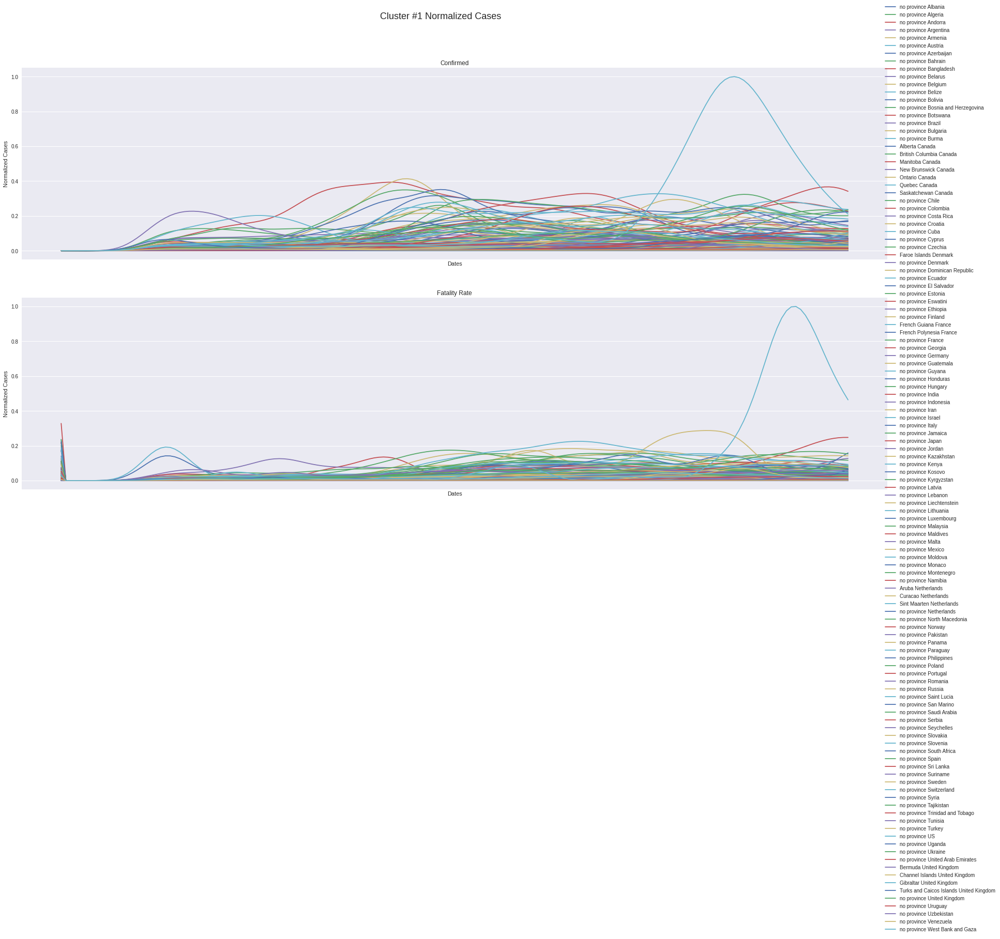

In [105]:
get_graphs(df_kshape, cluster_num=1)

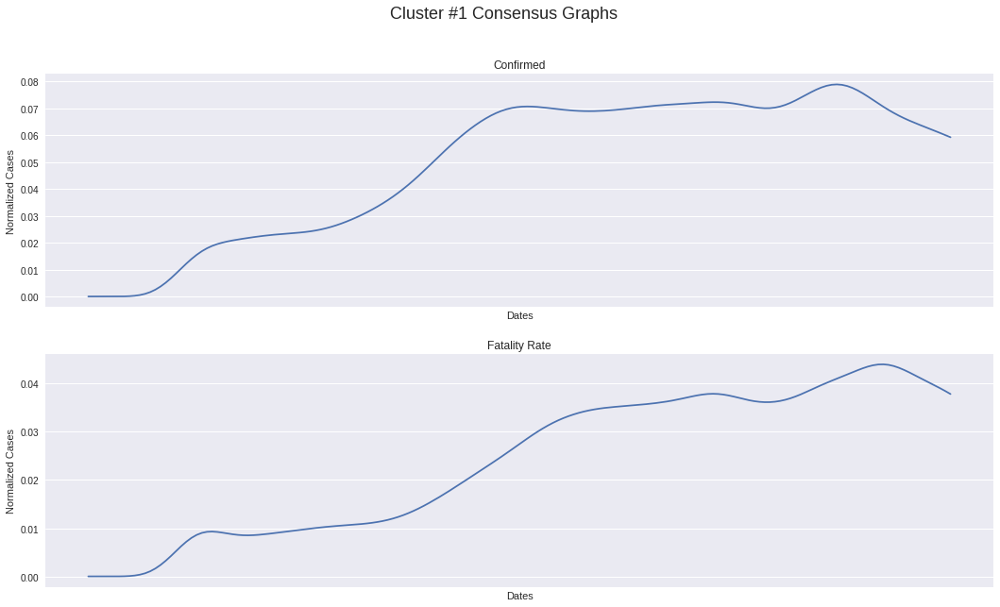

In [106]:
cluster0_kshape = get_consensus_2(df_kshape, cluster_num=1)

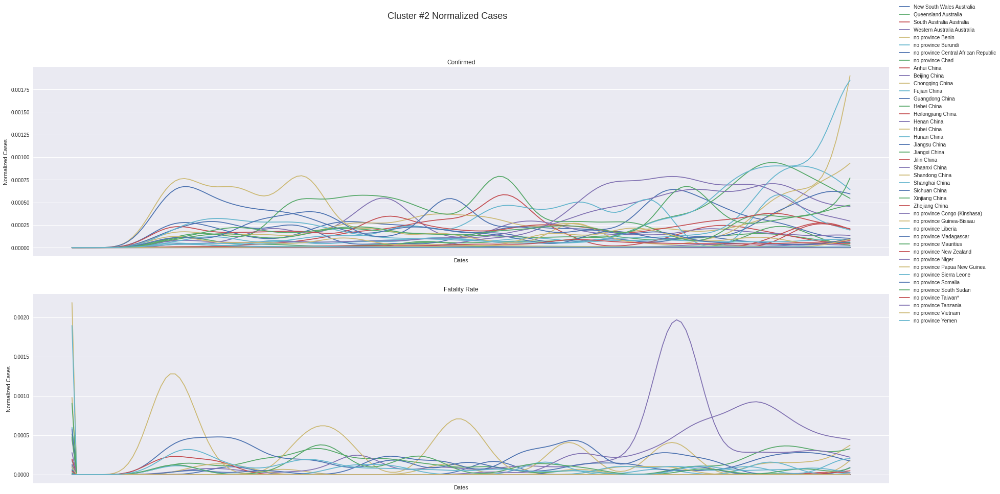

In [107]:
get_graphs(df_kshape, cluster_num=2)

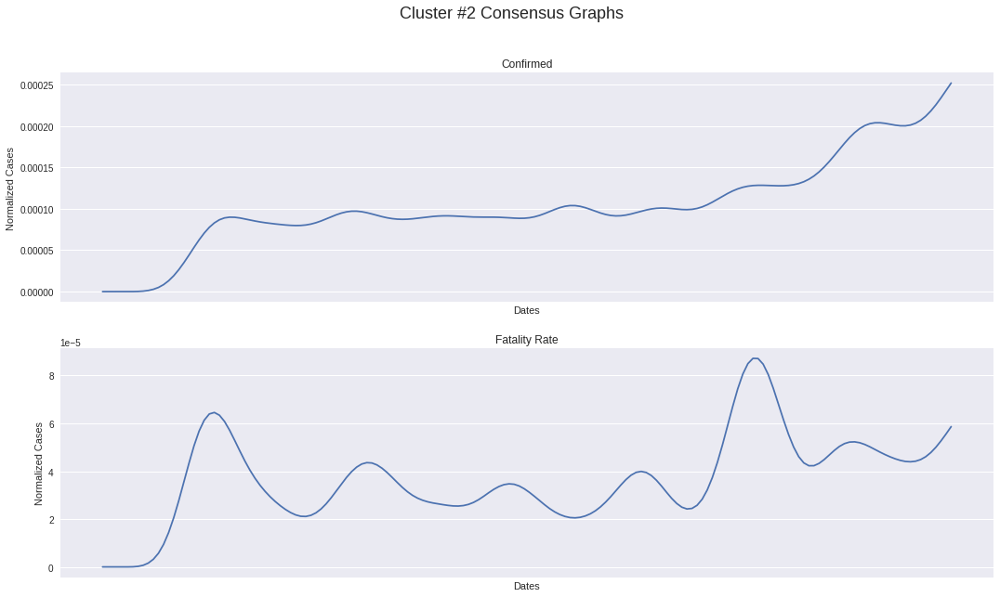

In [108]:
cluster1_kshape = get_consensus_2(df_kshape, cluster_num=2)

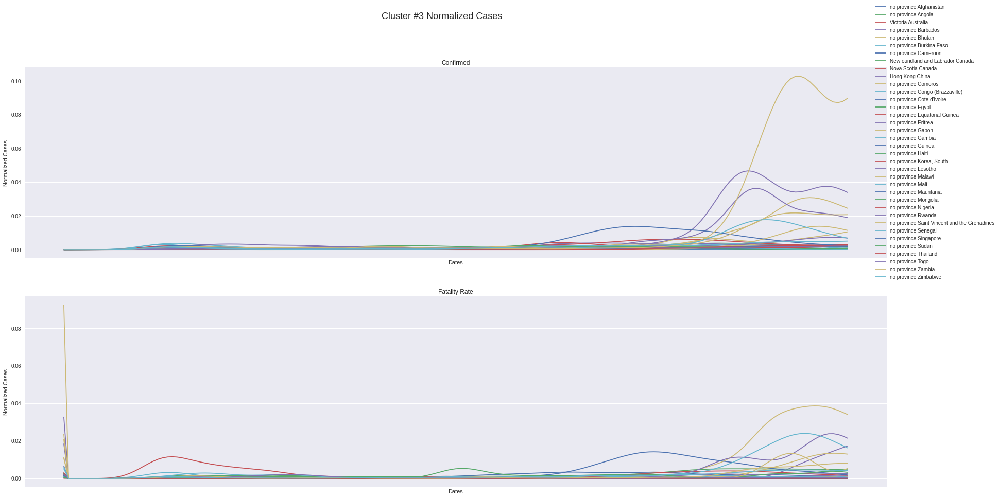

In [109]:
get_graphs(df_kshape, cluster_num=3)

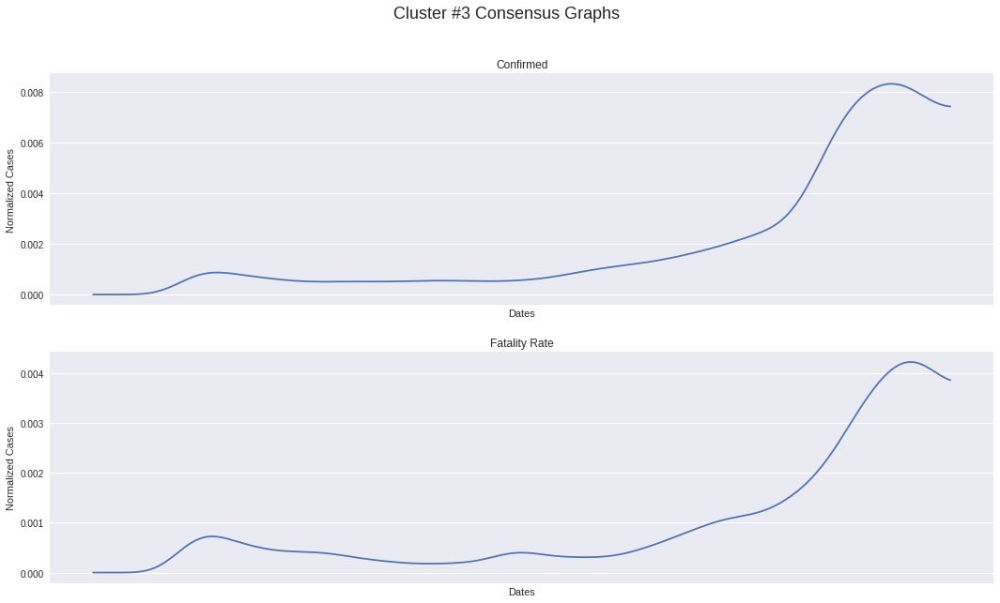

In [110]:
cluster2_kshape = get_consensus_2(df_kshape, cluster_num=3)

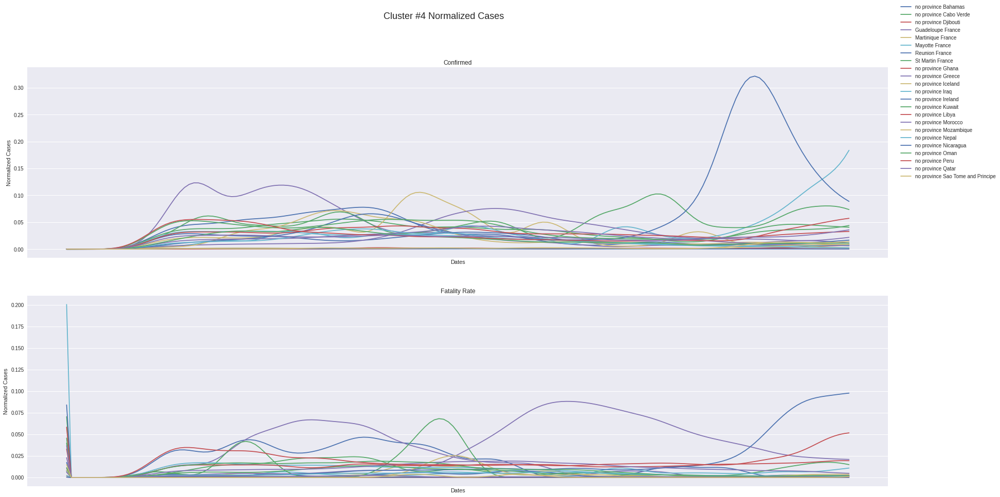

In [111]:
get_graphs(df_kshape, cluster_num=4)

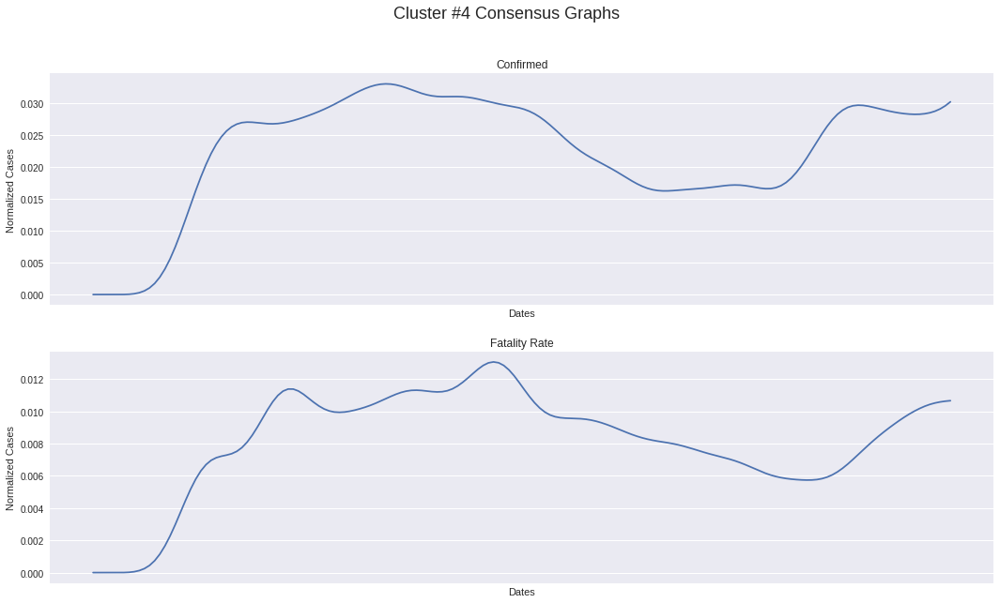

In [112]:
cluster3_kshape = get_consensus_2(df_kshape, cluster_num=4)

## K-means

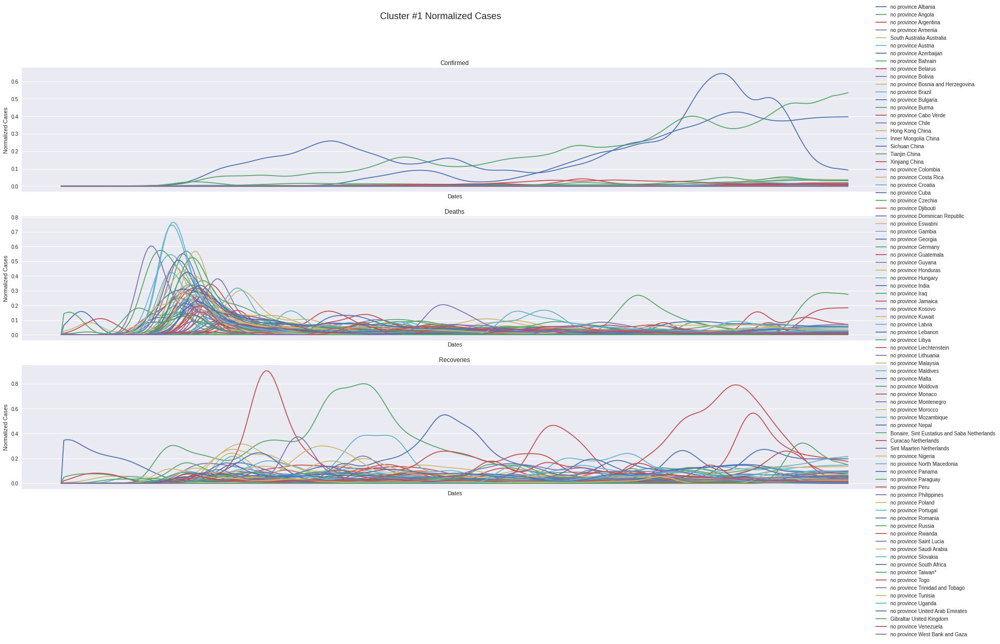

In [ ]:
get_graphs(df_kmeans, cluster_num=1)

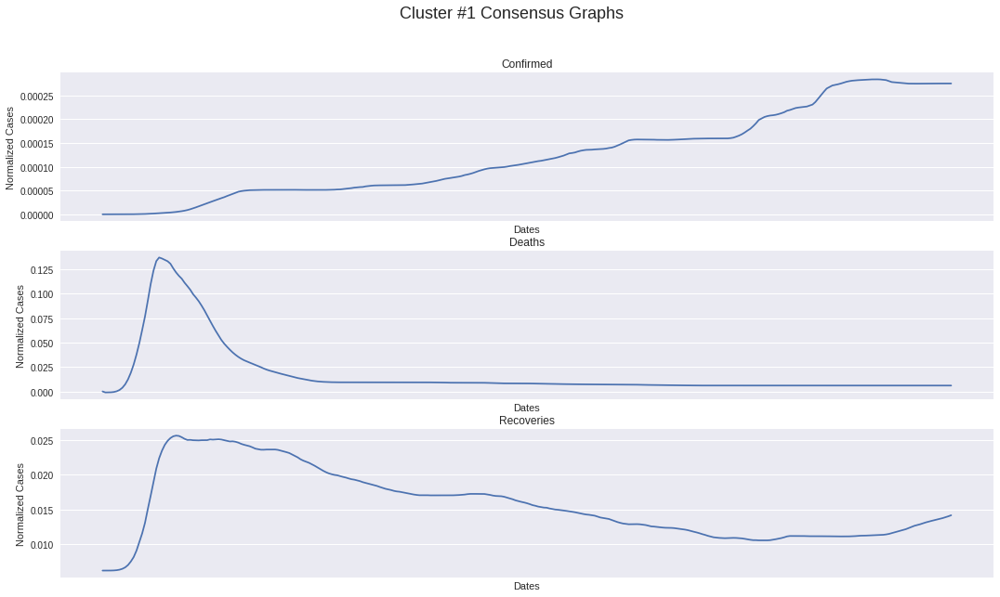

In [ ]:
cluster0_kmeans = get_consensus_2(df_kmeans, cluster_num=1)

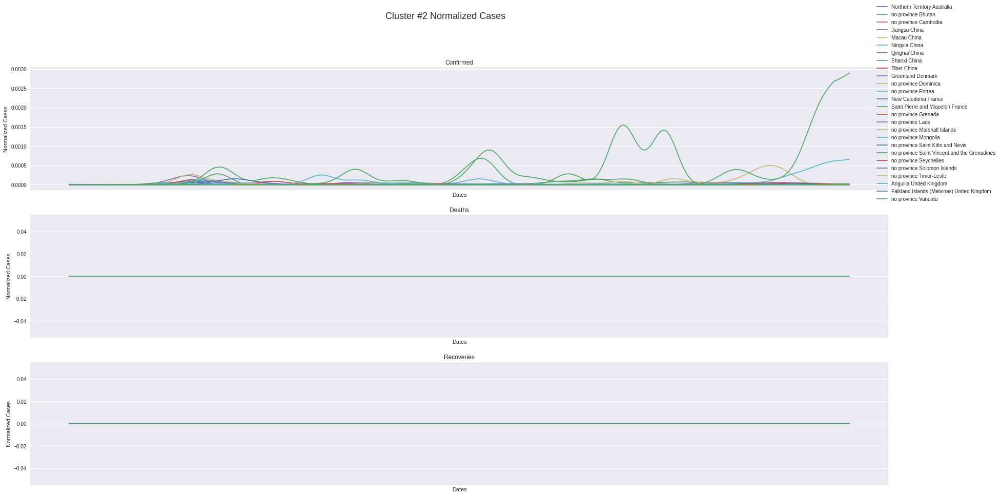

In [ ]:
get_graphs(df_kmeans, cluster_num=2)

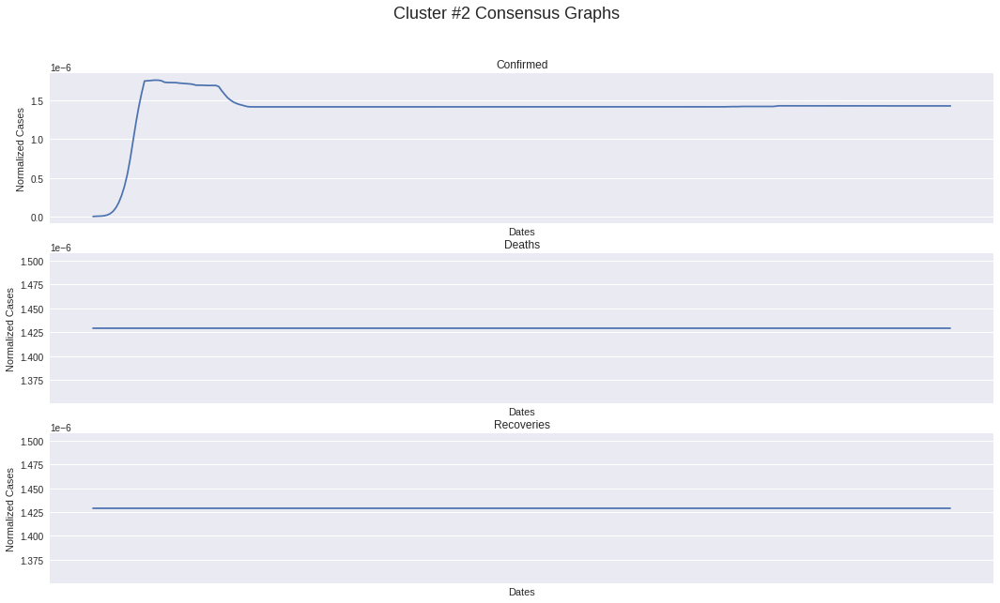

In [ ]:
cluster1_kmeans = get_consensus_2(df_kmeans, cluster_num=2)

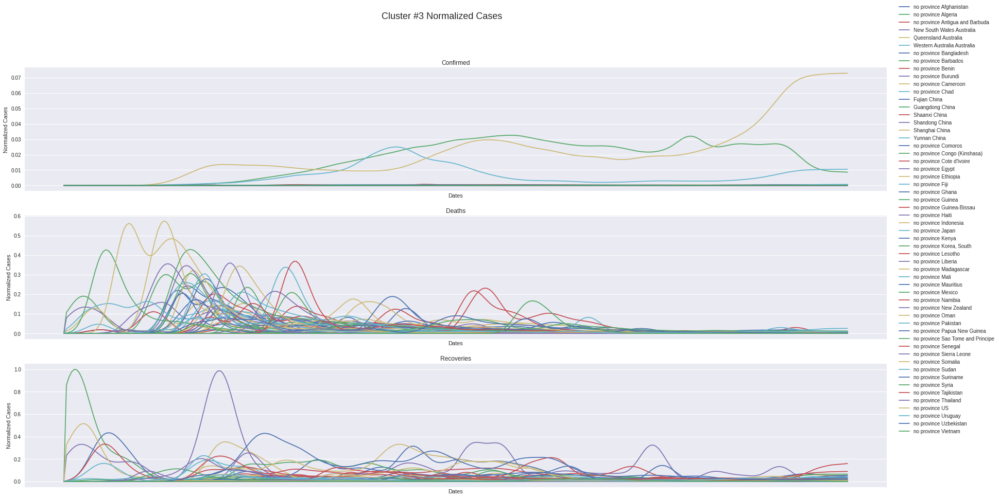

In [ ]:
get_graphs(df_kmeans, cluster_num=3)

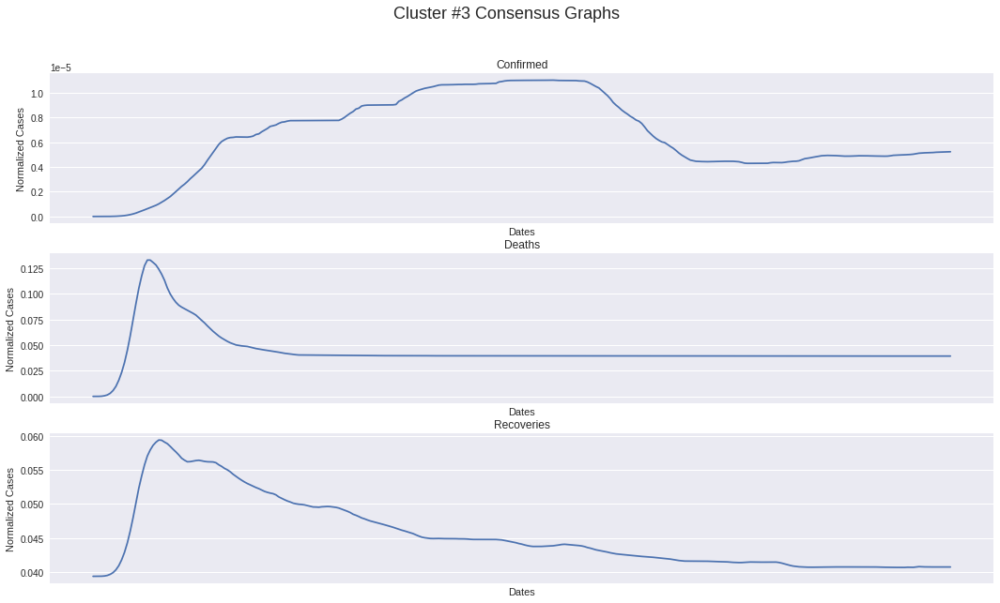

In [ ]:
cluster2_kmeans = get_consensus_2(df_kmeans, cluster_num=3)

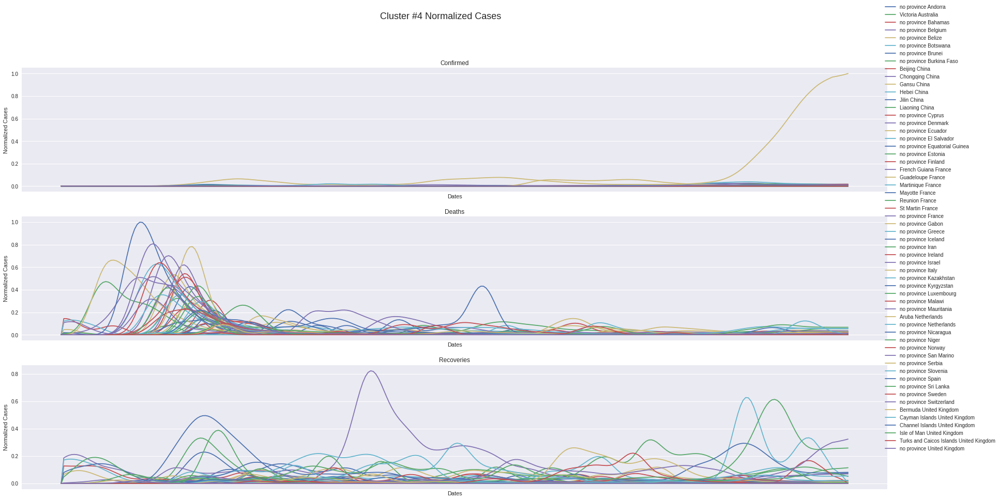

In [ ]:
get_graphs(df_kmeans, cluster_num=4)

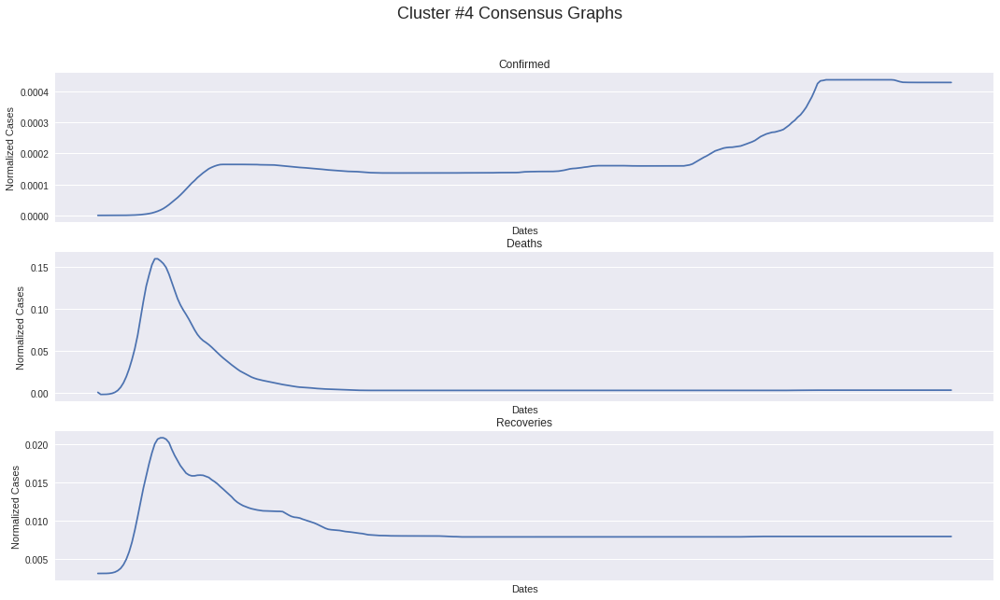

In [ ]:
cluster3_kmeans = get_consensus_2(df_kmeans, cluster_num=4)

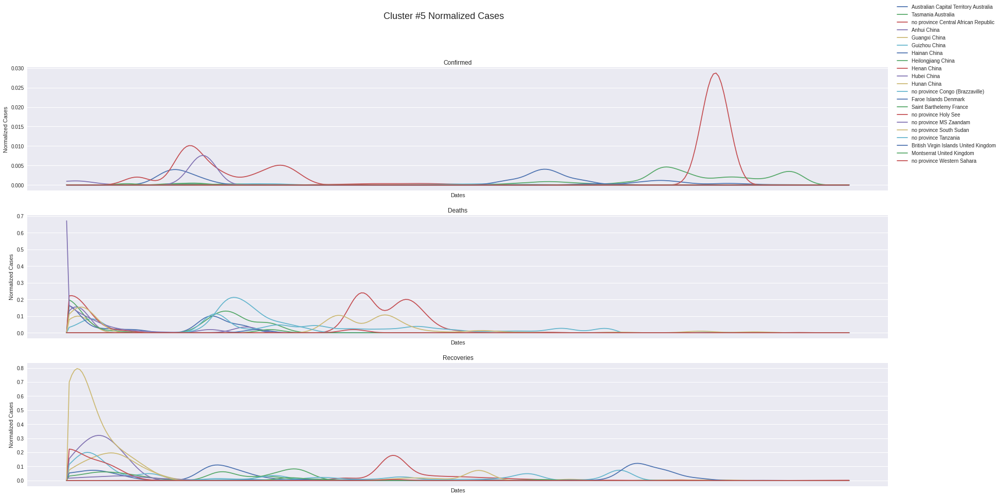

In [ ]:
get_graphs(df_kmeans, cluster_num=5)

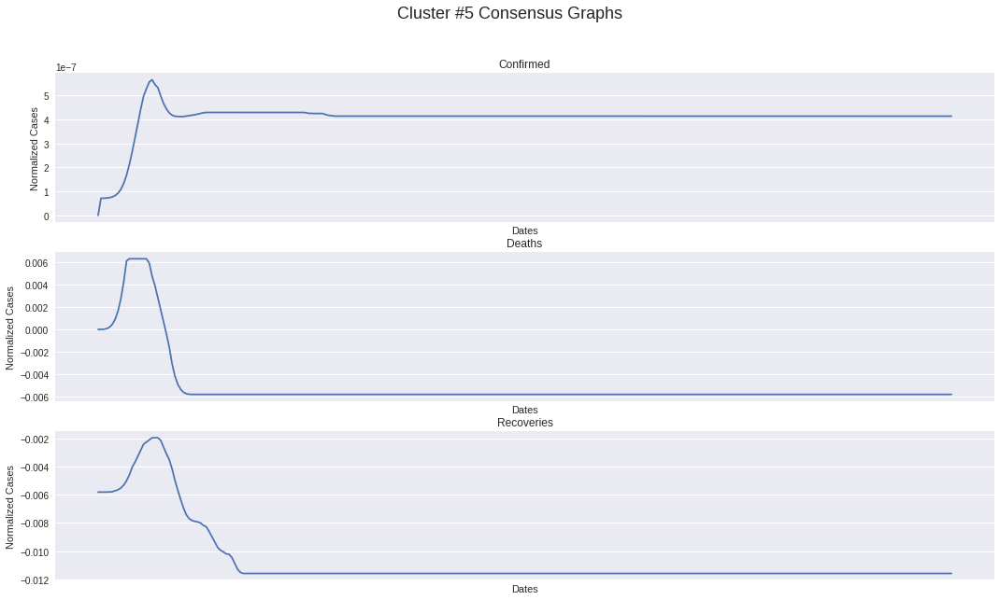

In [ ]:
cluster4_kmeans = get_consensus_2(df_kmeans, cluster_num=5)

## Consensus Shapes

In [113]:
# All countries
def get_all_consensus(df, num_divs=2):
  df = df.rename(columns={'label': 'alabel'})
  df = df.reindex(sorted(df.columns), axis=1)
  columns = df.columns[2:]
  num_columns = len(columns) // num_divs

  fig, ax = plt.subplots(num_divs, 1, figsize=(18,10))
  titles = ["Confirmed", "Deaths"]
  # titles = ["Confirmed", "Deaths", "Recoveries"]

  for i in range(num_divs):
    ax[i].set_title(titles[i])
    ax[i].set_xlabel("Dates")
    ax[i].set_ylabel("Normalized Cases")
    ax[i].get_xaxis().set_ticks([])

    x = columns[i*num_columns:i*num_columns + num_columns]
    for cluster_num in df['alabel'].unique():
      curr_df = df[df['alabel'] == cluster_num].iloc[0]
      y = curr_df[x]
        
      ax[i].plot(x,y,label=curr_df['area'])

  fig.suptitle('All Consensus Graphs'.format(cluster_num), fontsize=18)
  fig.legend(df['area'])

#### K-shape

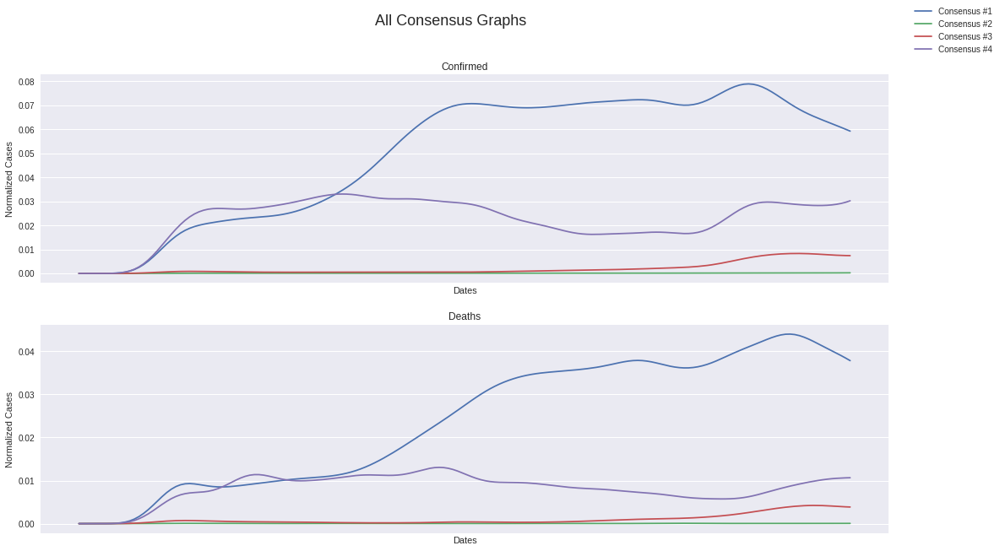

In [114]:
kshape_consensus = [
  cluster0_kshape,
  cluster1_kshape,
  cluster2_kshape,
  cluster3_kshape,
]
df_consensus_kshape = pd.DataFrame(kshape_consensus)

get_all_consensus(df_consensus_kshape)

#### K-means

In [ ]:
kmeans_consensus = [
  cluster0_kmeans,
  cluster1_kmeans,
  cluster2_kmeans,
  cluster3_kmeans,
  cluster4_kmeans,
]
df_consensus_kmeans = pd.DataFrame(kmeans_consensus)

get_all_consensus(df_consensus_kmeans)

NameError: ignored

# World Map

## Getting the Data

In [115]:
# countries = df_kmeans[['Province/State', 'Country/Region', 'labels']]
# countries['labels_kshape'] = df_kshape['labels']
countries = df_kshape.loc[:, ['Province/State', 'Country/Region', 'labels']]
countries.head()

,Province/State,Country/Region,labels
0,no province,Afghanistan,3
1,no province,Albania,1
2,no province,Algeria,1
3,no province,Andorra,1
4,no province,Angola,3


In [116]:
# Obtained from: https://github.com/datasets/country-codes
country_codes = pd.read_csv(os.path.join(BASE_DIR, 'visualization/country_codes.csv'))
country_codes = country_codes.rename(columns={'CLDR display name': 'Country/Region'})
country_codes.head()

,FIFA,Dial,ISO3166-1-Alpha-3,MARC,is_independent,ISO3166-1-numeric,GAUL,FIPS,WMO,ISO3166-1-Alpha-2,ITU,IOC,DS,UNTERM Spanish Formal,Global Code,Intermediate Region Code,official_name_fr,UNTERM French Short,ISO4217-currency_name,Developed / Developing Countries,UNTERM Russian Formal,UNTERM English Short,ISO4217-currency_alphabetic_code,Small Island Developing States (SIDS),UNTERM Spanish Short,ISO4217-currency_numeric_code,UNTERM Chinese Formal,UNTERM French Formal,UNTERM Russian Short,M49,Sub-region Code,Region Code,official_name_ar,ISO4217-currency_minor_unit,UNTERM Arabic Formal,UNTERM Chinese Short,Land Locked Developing Countries (LLDC),Intermediate Region Name,official_name_es,UNTERM English Formal,official_name_cn,official_name_en,ISO4217-currency_country_name,Least Developed Countries (LDC),Region Name,UNTERM Arabic Short,Sub-region Name,official_name_ru,Global Name,Capital,Continent,TLD,Languages,Geoname ID,Country/Region,EDGAR
0,TPE,886,TWN,ch,Yes,158.0,925,TW,,TW,,TPE,RC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taipei,AS,.tw,"zh-TW,zh,nan,hak",1668284.0,Taiwan,NaN
1,AFG,93,AFG,af,Yes,4.0,1,AF,AF,AF,AFG,AFG,AFG,República Islámica del Afganistán (la),True,NaN,Afghanistan,Afghanistan (l') [masc.],Afghani,Developing,Исламская Республика Афганистан,Afghanistan,AFN,NaN,Afganistán (el),971,阿富汗伊斯兰共和国,République islamique d'Afghanistan,Афганистан,4.0,34.0,142.0,أفغانستان,2,جمهورية أفغانستان الإسلامية,阿富汗,x,NaN,Afganistán,the Islamic Republic of Afghanistan,阿富汗,Afghanistan,AFGHANISTAN,x,Asia,أفغانستان,Southern Asia,Афганистан,World,Kabul,AS,.af,"fa-AF,ps,uz-AF,tk",1149361.0,Afghanistan,B2
2,ALB,355,ALB,aa,Yes,8.0,3,AL,AB,AL,ALB,ALB,AL,la República de Albania,True,NaN,Albanie,Albanie (l') [fém.],Lek,Developed,Республика Албания,Albania,ALL,NaN,Albania,008,阿尔巴尼亚共和国,la République d'Albanie,Албания,8.0,39.0,150.0,ألبانيا,2,جمهورية ألبانيا,阿尔巴尼亚,NaN,NaN,Albania,the Republic of Albania,阿尔巴尼亚,Albania,ALBANIA,NaN,Europe,ألبانيا,Southern Europe,Албания,World,Tirana,EU,.al,"sq,el",783754.0,Albania,B3
3,ALG,213,DZA,ae,Yes,12.0,4,AG,AL,DZ,ALG,ALG,DZ,la República Argelina Democrática y Popular,True,NaN,Algérie,Algérie (l') [fém.],Algerian Dinar,Developing,Алжирская Народная Демократическая Республика,Algeria,DZD,NaN,Argelia,012,阿尔及利亚民主人民共和国,la République algérienne démocratique et popul...,Алжир,12.0,15.0,2.0,الجزائر,2,الجمهورية الجزائرية الديمقراطية الشعبية,阿尔及利亚,NaN,NaN,Argelia,the People's Democratic Republic of Algeria,阿尔及利亚,Algeria,ALGERIA,NaN,Africa,الجزائر,Northern Africa,Алжир,World,Algiers,AF,.dz,ar-DZ,2589581.0,Algeria,B4
4,ASA,1-684,ASM,as,Territory of US,16.0,5,AQ,,AS,SMA,ASA,USA,NaN,True,NaN,Samoa américaines,NaN,US Dollar,Developing,NaN,NaN,USD,x,NaN,840,NaN,NaN,NaN,16.0,61.0,9.0,ساموا الأمريكية,2,NaN,NaN,NaN,NaN,Samoa Americana,NaN,美属萨摩亚,American Samoa,AMERICAN SAMOA,NaN,Oceania,NaN,Polynesia,Американское Самоа,World,Pago Pago,OC,.as,"en-AS,sm,to",5880801.0,American Samoa,B5


#### Filling the NaN values

In [117]:
# Remove all provinces
countries = countries.drop(countries[countries.duplicated(['Country/Region'], keep='last')].index)

In [118]:
# Antigua and Barbuda
def change_country_name(df, old_value, new_value, column='Country/Region'):
  try:
    index = df[df[column] == old_value].index[0]
    df.at[index, column] = new_value
    print(f'Changed from {old_value} to {new_value}')
  except IndexError:
    print(f'{old_value} not found in the dataset!')

In [119]:
# Antigua and Barbuda
change_country_name(countries, 'Antigua and Barbuda', 'Antigua & Barbuda')

# Bosnia and Herzegovina
change_country_name(countries, 'Bosnia and Herzegovina', 'Bosnia')

# Myanmar
change_country_name(countries, 'Burma', 'Myanmar')

# Cape Verde
change_country_name(countries, 'Cabo Verde', 'Cape Verde')

# Congo (Brazzaville)
change_country_name(countries, 'Congo (Brazzaville)', 'Congo - Brazzaville')

# Congo (Kinshasa)
change_country_name(countries, 'Congo (Kinshasa)', 'Congo - Kinshasa')

# Côte d’Ivoire
change_country_name(countries, "Cote d'Ivoire", 'Côte d’Ivoire')

# Vatican City
change_country_name(countries, "Holy See", 'Vatican City')

# South Korea
change_country_name(countries, "Korea, South", 'South Korea')

# Kosovo - not in dataset
# change_country_name(countries, "Kosovo", 'Vatican City')

# MS Zaandam - not in dataset

# Saint Kitts and Nevis
change_country_name(countries, "Saint Kitts and Nevis", 'St. Kitts & Nevis')

# Saint Lucia
change_country_name(countries, "Saint Lucia", 'St. Lucia')

# Saint Vincent and the Grenadines
change_country_name(countries, "Saint Vincent and the Grenadines", 'St. Vincent & Grenadines')

# Sao Tome and Principe
change_country_name(countries, "Sao Tome and Principe", 'St. Lucia')

# Saint Lucia
change_country_name(countries, "Saint Lucia", 'St. Lucia')

# Taiwan
change_country_name(countries, "Taiwan*", 'Taiwan')

# Saint Lucia
change_country_name(countries, "Trinidad and Tobago", 'Trinidad & Tobago')

# UK
change_country_name(countries, "United Kingdom", 'UK')

# West Bank and Gaza - not in dataset

Antigua and Barbuda not found in the dataset!
Changed from Bosnia and Herzegovina to Bosnia
Changed from Burma to Myanmar
Changed from Cabo Verde to Cape Verde
Changed from Congo (Brazzaville) to Congo - Brazzaville
Changed from Congo (Kinshasa) to Congo - Kinshasa
Changed from Cote d'Ivoire to Côte d’Ivoire
Holy See not found in the dataset!
Changed from Korea, South to South Korea
Saint Kitts and Nevis not found in the dataset!
Changed from Saint Lucia to St. Lucia
Changed from Saint Vincent and the Grenadines to St. Vincent & Grenadines
Changed from Sao Tome and Principe to St. Lucia
Saint Lucia not found in the dataset!
Changed from Taiwan* to Taiwan
Changed from Trinidad and Tobago to Trinidad & Tobago
Changed from United Kingdom to UK


In [120]:
countries = countries.dropna()

#### Merging the Countries and JSON

In [121]:
new_countries = countries.merge(country_codes, how='left', on='Country/Region')[['Province/State', 'Country/Region', 'labels', 'ISO3166-1-Alpha-3']]
# new_countries = countries.merge(country_codes, how='left', on='Country/Region')[['Province/State', 'Country/Region', 'labels', 'labels_kshape', 'ISO3166-1-Alpha-3']]
new_countries = new_countries.rename(columns={'ISO3166-1-Alpha-3': 'ID'})
new_countries = new_countries[['ID', 'labels']]
# new_countries = new_countries[['ID', 'labels', 'labels_kshape']]
new_countries.head()

,ID,labels
0,AFG,3
1,ALB,1
2,DZA,1
3,AND,1
4,AGO,3


### Visualizing the Data

In [122]:
# Import Countries JSON file
import json

# Obtained from: https://datahub.io/core/geo-countries
with open(os.path.join(BASE_DIR, 'visualization/countries_geojson.json')) as f:
  countries_geojson = json.load(f)

new_countries.head()

,ID,labels
0,AFG,3
1,ALB,1
2,DZA,1
3,AND,1
4,AGO,3


#### K-Shape

In [123]:
import folium
m_kshape = folium.Map(location=[48, -102], zoom_start=1)
folium.Choropleth(
    geo_data=countries_geojson,
    name='choropleth',
    data=new_countries,
    columns=['ID', 'labels'],
    # columns=['ID', 'labels_kshape'],
    key_on='feature.properties.ISO_A3',
    fill_color='PuBuGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='COVID Cluster'
).add_to(m_kshape)

folium.LayerControl().add_to(m_kshape)

m_kshape

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# m.save('cluster_map_kmeans.html')
m_kshape.save('cluster_map_kshape.html')

#### K-Means

In [ ]:
import folium

m = folium.Map(location=[48, -102], zoom_start=1)
folium.Choropleth(
    geo_data=countries_geojson,
    name='choropleth',
    data=new_countries,
    columns=['ID', 'labels'],
    key_on='feature.properties.ISO_A3',
    fill_color='PuBuGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='COVID Cluster'
).add_to(m)

folium.LayerControl().add_to(m)

m